In [3]:
import os
import glob
import pandas as pd
from utils import *
from eeg_qc import *
from et_qc import *
from ecg_qc import *
from eda_qc import *
from rsp_qc import *
from mic_qc import *
from webcam_qc import *
from behavior_qc import *


## Get file path and subject ID

In [2]:
pathname = "/Users/apurva.gokhe/Documents/CUNY_QC/data/*/*.xdf"
subject = glob(pathname)[-1]
subject_id = subject.split('-')[1].split('/')[0]
subject_id

'P5548165'

## Run QC for all modalities (for 1 subject)

### EEG

In [ ]:
eeg_vars = compute_eeg_pipeline(subject)
eeg_vars,_ = {f"eeg_{key}": value for key, value in eeg_vars.items()}
eeg_vars

### Eye Tracking

Effective sampling rate: 119.9959
Flag: all coordinates have the same % validity within each measure (LR, gaze point/origin/diameter): True
Flag: % of NaNs is the same between coordinate systems (UCS and TBCS (gaze origin) and between UCS and display area (gaze point)): True
Mean difference in percent valid data between right and left eyes: 0.9969%
Percent of data with gaze point differences of over 0.2 mm: 4.7225%


{'et_sampling_rate': np.float64(119.99586160597286),
 'et_flag1': True,
 'et_flag2': True,
 'et_LR_mean_diff': 0.009968834598201526,
 'et_percent_over02': 0.04722543515671284}

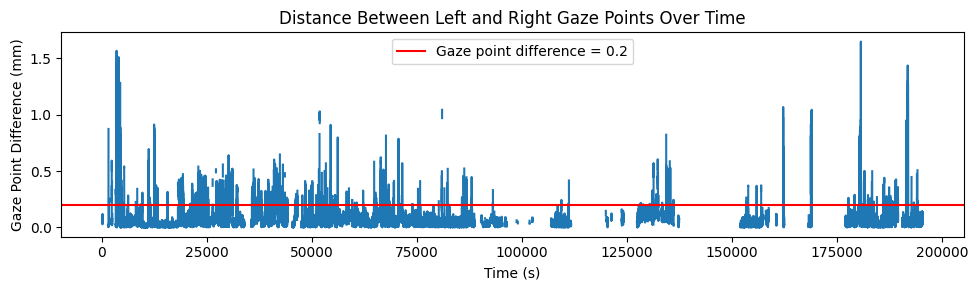

In [3]:
et_vars = et_qc(subject)
et_vars = {f"et_{key}": value for key, value in et_vars.items()}
et_vars

### ECG

Effective sampling rate: 999.7872778660745
Average heart rate: 76.83019740476108
Kurtosis signal quality index: 9.447244789202726
Power spectrum distribution signal quality index: 0.7386379549179376
Relative power in baseline signal quality index: 19.11755089639917
Signal to Noise Ratio: 9.129206971703915


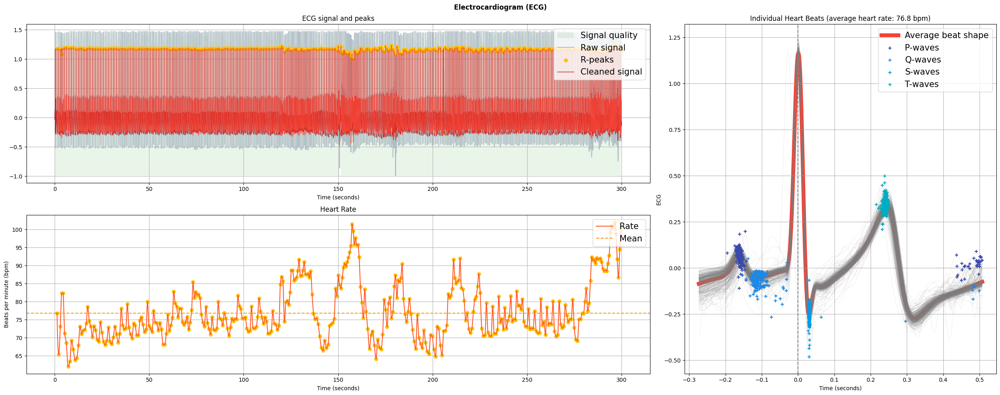

{'ecg_sampling_rate': np.float64(999.7872778660745),
 'ecg_average_heart_rate': 76.83019740476108,
 'ecg_kurtosis_SQI': 9.447244789202726,
 'ecg_power_spectrum_distribution_SQI': 0.7386379549179376,
 'ecg_relative_baseline_power_sqi': 19.11755089639917,
 'ecg_SNR': 9.129206971703915}

In [4]:
ecg_vars, _ = ecg_qc(subject)
ecg_vars = {f"ecg_{key}": value for key, value in ecg_vars.items()}
ecg_vars

### EDA

Effective sampling rate: 999.787 Hz
Signal Integrity Check: 100.000 %
Average Skin Conductance Level: 3.454 mS
Skin Conductance Level Standard deviation: 0.926 mS
Skin Conductance Level Coefficient of Variation: 26.802 %
Average Amplitude of Skin Conductance Response: 0.012 mS
Skin Conductance Response Validity: 33.333 %
Signal to Noise Ratio: 54.191 dB


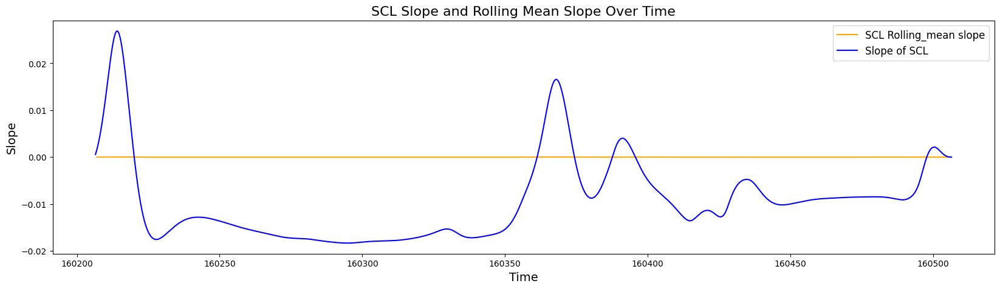

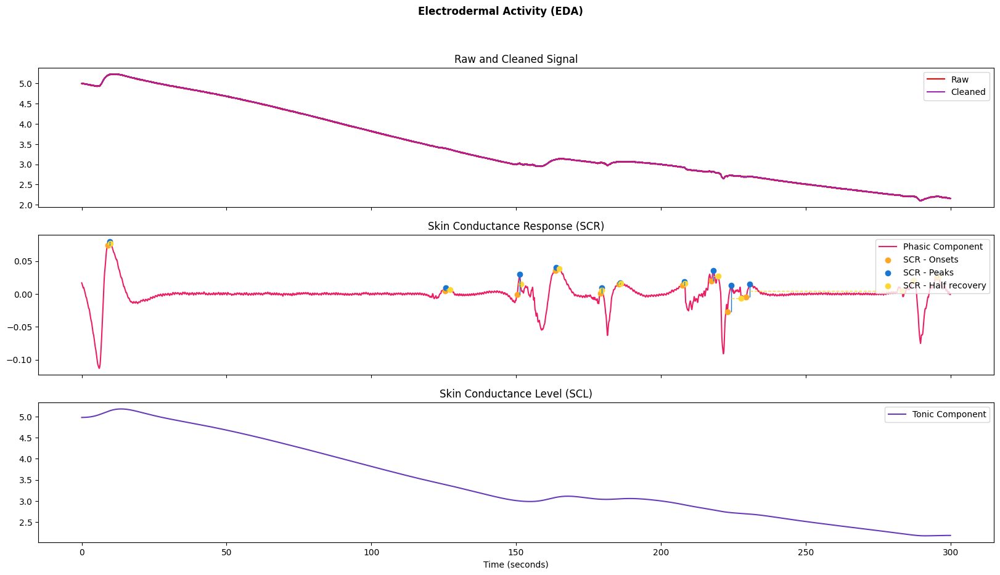

{'eda_sampling_rate': np.float64(999.7872778660745),
 'eda_signal_integrity_check': 100.0,
 'eda_average_scl': np.float64(3.4538905194003315),
 'eda_scl_sd': np.float64(0.9257058292380149),
 'eda_scl_cv': np.float64(26.801828953128982),
 'eda_average_scr_amplitude': np.float64(0.012136487606792652),
 'eda_sc_validity': 33.33333333333334,
 'eda_snr': np.float64(54.191313284148265)}

In [5]:
eda_vars, _, _ = eda_qc(subject)
eda_vars = {f"eda_{key}": value for key, value in eda_vars.items()}
eda_vars

### RSP

Effective sampling rate: 1000.2160
Signal to Noise Ratio: -2.2314
Breath amplitude mean: 0.3457
Breath amplitude std: 0.2999
Breath amplitude range: 0.0717 - 2.6935
Respiration rate mean: 19.5774
Respiration rate std: 2.9536
Respiration rate range: 3.7634 - 29.2573
Peak to peak interval mean: 3.0705
Peak to peak interval std: 1.2067
Peak to peak interval range: 0.4271 - 14.5336
Baseline drift: 0.2341
Autocorrelation at typical breath cycle: 0.5721


{'rsp_sampling_rate': np.float64(1000.2160368978896),
 'rsp_rsp_snr': np.float64(-2.2313846680045875),
 'rsp_breath_amplitude_mean': np.float64(0.34569753880551984),
 'rsp_breath_amplitude_std': np.float64(0.299888328955345),
 'rsp_breath_amplitude_range': '0.0717 - 2.6935',
 'rsp_rsp_rate_mean': np.float64(19.577376334072753),
 'rsp_rsp_rate_std': np.float64(2.953642729984398),
 'rsp_rsp_rate_range': '3.7634 - 29.2573',
 'rsp_ptp_mean': np.float64(3.070503074122157),
 'rsp_ptp_std': np.float64(1.2067130001329591),
 'rsp_ptp_range': '0.4271 - 14.5336',
 'rsp_baseline_drift': np.float64(0.2341272968820966),
 'rsp_autocorrelation': np.float64(0.5720711044793361)}

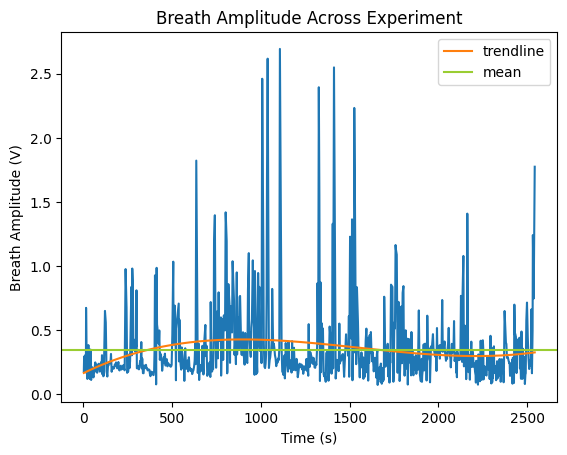

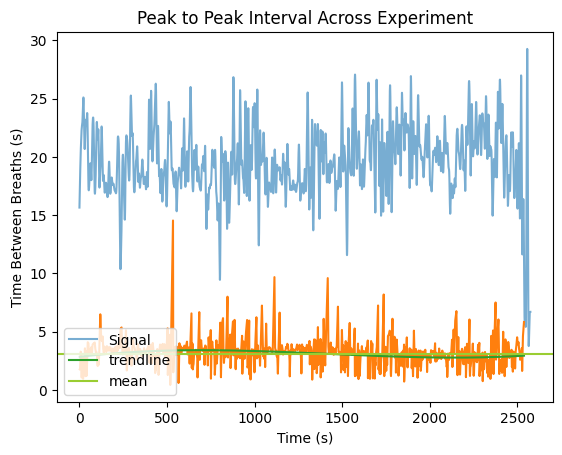

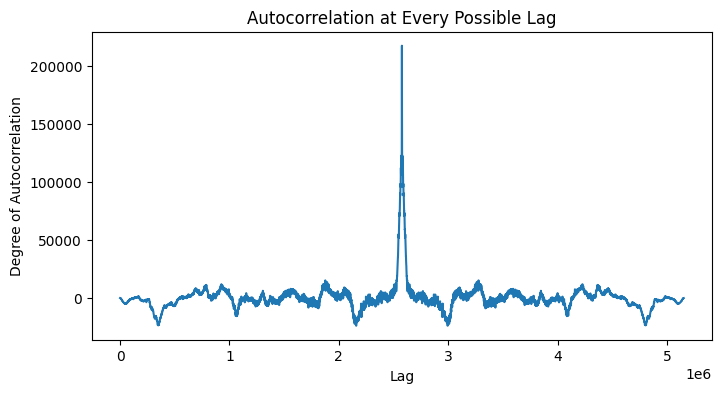

In [6]:
rsp_vars = rsp_qc(subject)
rsp_vars = {f"rsp_{key}": value for key, value in rsp_vars.items()}
rsp_vars

### Mic

Effective sampling rate: 44099.3428
Difference between .wav file and lsl timestamps durations: 35.5470
number of NaN's: 0 
percent of NaN's: 0.0000%
mic samples first quartile: -37.0 
mic samples third quartile: 37.0
mic samples standard deviation: 141.4715
mic samples min: -8106 
mic samples max: 7418


AttributeError: 'tuple' object has no attribute 'items'

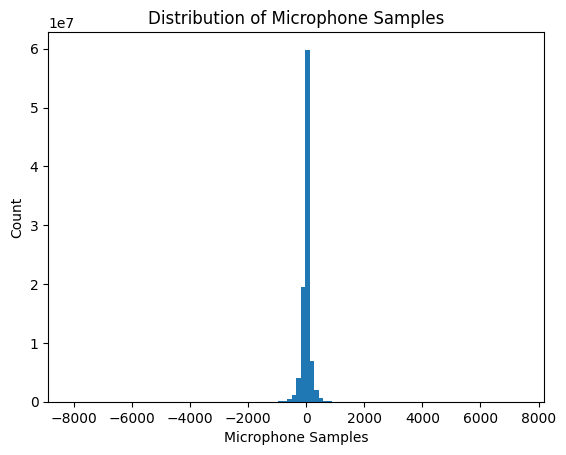

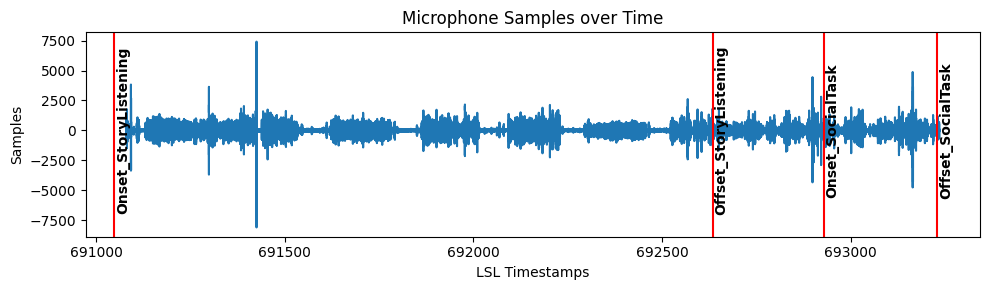

In [4]:
stim_df = import_stim_data(subject)
mic_vars = mic_qc(subject, stim_df)
mic_vars,_ = {f"mic_{key}": value for key, value in mic_vars.items()}
mic_vars

### Webcam

RestingState duration matches camera duration!
RestingState:  299.999547179963
Webcam Stream:  299.99179364927113


[mpeg4 @ 0x167fca700] ac-tex damaged at 3 18
[mpeg4 @ 0x167fca700] Error at MB: 741
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is no keyframe
[mpeg4 @ 0x137559330] warning: first frame is 

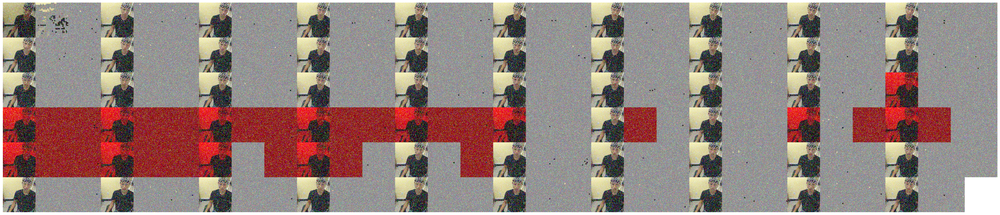

{'webcam_collected_full_RestingState': True,
 'webcam_sampling_rate': np.float64(29.89572542350607),
 'webcam_face_perc': 0.8182831661092531}

In [8]:
# add video file
webcam_file = glob(f'/Users/apurva.gokhe/Documents/CUNY_QC/data/sub-{subject_id}/*.avi')[0]
webcam_vars = webcam_qc(xdf_filename=subject, video_file=webcam_file, task='RestingState')
webcam_vars = {f"webcam_{key}": value for key, value in webcam_vars.items()}
webcam_vars

### Behavior

In [9]:
behavior_vars = behavior_qc(subject)
behavior_vars = {f"behavior_{key}": value for key, value in behavior_vars.items()}
behavior_vars

Missing stimulus markers: None
Duration of experiment: 39:57
Durations do not match expected length: ['Onset_CampFriend', 'Onset_FrogDissection', 'Onset_DanceContest', 'Onset_ZoomClass', 'Onset_Tornado', 'Onset_BirthdayParty']
299.999547179963
Is Resting state of expected duration? True
300.50497861159965
Is Social script of expected duration? True
Duration of Impedance check: 07:30
Are all 10 seconds rest equal? True
Average response time across all story listening tasks: 00:28


{'behavior_missing_stimulus_markers': None,
 'behavior_total_duration': '39:57',
 'behavior_unexpected_durations': ['Onset_CampFriend',
  'Onset_FrogDissection',
  'Onset_DanceContest',
  'Onset_ZoomClass',
  'Onset_Tornado',
  'Onset_BirthdayParty'],
 'behavior_impedance_check_duration': '07:30',
 'behavior_ten_seconds_rest': True,
 'behavior_average_response_time': '00:28'}

## Generate dataframe with all qc metrics for all modalities (for 1 subject)

In [10]:
subject_csv = {'Subject': subject_id}
#subject_csv.update(eeg_vars)
subject_csv.update(et_vars)
subject_csv.update(ecg_vars)
subject_csv.update(eda_vars)
subject_csv.update(rsp_vars)
subject_csv.update(mic_vars)
subject_csv.update(webcam_vars)
subject_csv.update(behavior_vars)
subject_csv

{'Subject': 'P5882302',
 'et_sampling_rate': np.float64(119.99586160597286),
 'et_flag1': True,
 'et_flag2': True,
 'et_LR_mean_diff': 0.009968834598201526,
 'et_percent_over02': 0.04722543515671284,
 'ecg_sampling_rate': np.float64(999.7872778660745),
 'ecg_average_heart_rate': 76.83019740476108,
 'ecg_kurtosis_SQI': 9.447244789202726,
 'ecg_power_spectrum_distribution_SQI': 0.7386379549179376,
 'ecg_relative_baseline_power_sqi': 19.11755089639917,
 'ecg_SNR': 9.129206971703915,
 'eda_sampling_rate': np.float64(999.7872778660745),
 'eda_signal_integrity_check': 100.0,
 'eda_average_scl': np.float64(3.4538905194003315),
 'eda_scl_sd': np.float64(0.9257058292380149),
 'eda_scl_cv': np.float64(26.801828953128982),
 'eda_average_scr_amplitude': np.float64(0.012136487606792652),
 'eda_sc_validity': 33.33333333333334,
 'eda_snr': np.float64(54.191313284148265),
 'rsp_sampling_rate': np.float64(1000.2160368978896),
 'rsp_rsp_snr': np.float64(-2.2313846680045875),
 'rsp_breath_amplitude_mean'

In [11]:
subject_csv_df = pd.DataFrame([subject_csv])
subject_csv_df

,Subject,et_sampling_rate,et_flag1,et_flag2,et_LR_mean_diff,et_percent_over02,ecg_sampling_rate,ecg_average_heart_rate,ecg_kurtosis_SQI,ecg_power_spectrum_distribution_SQI,...,mic_max,webcam_collected_full_RestingState,webcam_sampling_rate,webcam_face_perc,behavior_missing_stimulus_markers,behavior_total_duration,behavior_unexpected_durations,behavior_impedance_check_duration,behavior_ten_seconds_rest,behavior_average_response_time
0,P5882302,119.995862,True,True,0.009969,0.047225,999.787278,76.830197,9.447245,0.738638,...,10068,True,29.895725,0.818283,None,39:57,"[Onset_CampFriend, Onset_FrogDissection, Onset...",07:30,True,00:28


In [ ]:
if os.path.exists('CUNY_QC.csv'):
    subject_csv_df.to_csv('CUNY_QC.csv', mode='a', index=False, header=False)
else:
    subject_csv_df.to_csv('CUNY_QC.csv', mode='a', index=False, header=True)

## Combine all and run through all participants (locally)

In [13]:
def add_to_csv(subject_path):
    stim_df = import_stim_data(subject_path)
    subject_id = subject_path.split('-')[1].split('/')[0]

    collection_data = get_collection_date(subject_path)

    eeg_vars,_,_,_ = compute_eeg_pipeline(subject_path, task='RestingState')
    eeg_vars = {f"eeg_{key}": value for key, value in eeg_vars.items()}

    et_vars,_ = et_qc(subject_path)
    et_vars = {f"et_{key}": value for key, value in et_vars.items()}

    ecg_vars,_, _= ecg_qc(subject_path, stim_df)
    ecg_vars = {f"ecg_{key}": value for key, value in ecg_vars.items()}

    eda_vars,_,_,_ = eda_qc(subject_path, stim_df)
    eda_vars = {f"eda_{key}": value for key, value in eda_vars.items()}

    rsp_vars,_ = rsp_qc(subject_path)
    rsp_vars = {f"rsp_{key}": value for key, value in rsp_vars.items()}

    mic_vars,_ = mic_qc(subject_path)
    mic_vars = {f"mic_{key}": value for key, value in mic_vars.items()}

    webcam_file = glob(f'/Users/apurva.gokhe/Documents/CUNY_QC/data/sub-{subject_id}/*.avi')[0]
    webcam_vars,_ = webcam_qc(xdf_filename=subject_path, video_file=webcam_file, task='RestingState')
    webcam_vars = {f"webcam_{key}": value for key, value in webcam_vars.items()}

    behavior_vars = behavior_qc(subject_path)
    behavior_vars = {f"behavior_{key}": value for key, value in behavior_vars.items()}
    
    subject_csv = {'Subject': subject_id, 'Collection Date': collection_data}
    subject_csv.update(eeg_vars)
    subject_csv.update(et_vars)
    subject_csv.update(ecg_vars)
    subject_csv.update(eda_vars)
    subject_csv.update(rsp_vars)
    subject_csv.update(mic_vars)
    subject_csv.update(webcam_vars)
    subject_csv.update(behavior_vars)

    subject_csv_df = pd.DataFrame([subject_csv])

    if os.path.exists('CUNY_QC.csv'):
        subject_csv_df.to_csv('CUNY_QC.csv', mode='a', index=False, header=False)
    else:
        subject_csv_df.to_csv('CUNY_QC.csv', mode='a', index=False, header=True)
        
    

Opening raw data file /Users/apurva.gokhe/Documents/CUNY_QC/data/sub-P5597531/sub-P5597531_ses-S001_task-CUNY_run-001_eeg_clean.fif...
    Range : 0 ... 299988 =      0.000 ...   299.998 secs
Ready.
Reading 0 ... 299988  =      0.000 ...   299.998 secs...
Bad channels before robust reference: ['E94', 'Cz', 'E14', 'E56', 'E21', 'E55', 'E44', 'E17']
Interpolated channels: ['E94', 'Cz', 'E14', 'E56', 'E21', 'E55', 'E25', 'E44', 'E18', 'E125', 'E17', 'E62', 'E126', 'E128']
Bad channels after interpolation: ['E6', 'E99']
Using EOG channels: E25, E8
EOG channel index for this subject is: [24  7]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Selecting channel E8 for blink detection
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done 129 out of 129 | elapsed:    0.8s finished


Setting up low-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1651 samples (1.651 s)

Percent Good Data: 80.98%
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 59 - 61 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 59.35
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 59.10 Hz)
- Upper passband edge: 60.65 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 60.90 Hz)
- Filter length: 6601 samples (6.601 s)



[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 3301 samples (3.301 s)



[Parallel(n_jobs=1)]: Done 129 out of 129 | elapsed:    0.7s finished
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Fitting ICA to data using 127 channels (please be patient, this may take a while)
Omitting 57120 of 299989 (19.04%) samples, retaining 242869 (80.96%) samples.


[Parallel(n_jobs=1)]: Done 129 out of 129 | elapsed:    0.8s finished


Selecting by explained variance: 13 components
Fitting ICA took 8.3s.
Effective sampling rate: 119.9960
Flag: all coordinates have the same % validity within each measure (LR, gaze point/origin/diameter): True
Flag: % of NaNs is the same between coordinate systems (UCS and TBCS (gaze origin) and between UCS and display area (gaze point)): True
Mean difference in percent valid data between right and left eyes: 12.2454%
Percent of data with gaze point differences of over 0.2 mm: 0.7347%
Effective sampling rate: 599.5584586162964
Average heart rate: 77.57921111561615
Kurtosis signal quality index: 17.321374775016025
Power spectrum distribution signal quality index: 0.7741080413669413
Relative power in baseline signal quality index: 32.00785707711602
Signal to Noise Ratio: 9.477462290252237


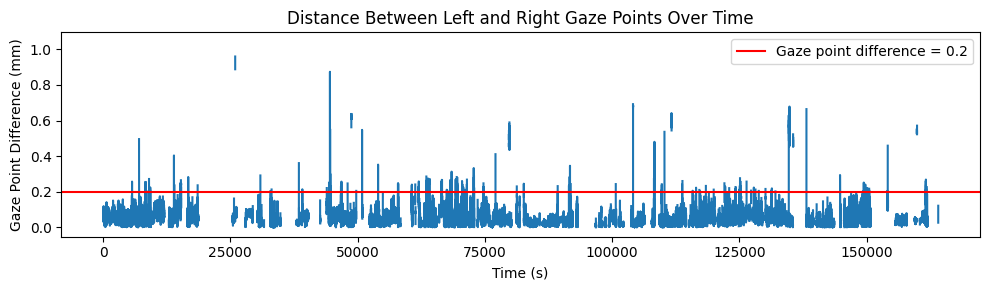

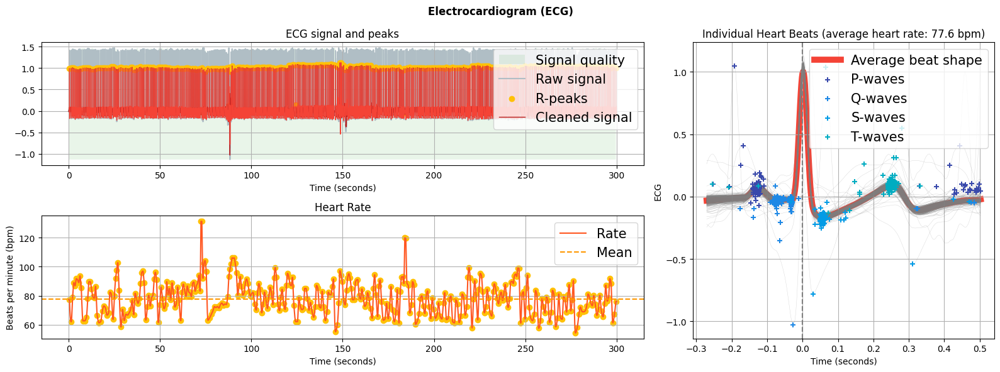

Effective sampling rate: 599.558 Hz
Signal Integrity Check: 100.000 %
Average Skin Conductance Level: 6.364 mS
Skin Conductance Level Standard deviation: 0.984 mS
Skin Conductance Level Coefficient of Variation: 15.457 %
Average Amplitude of Skin Conductance Response: 0.837 mS
Skin Conductance Response Validity: 100.000 %
Signal to Noise Ratio: 48.325 dB


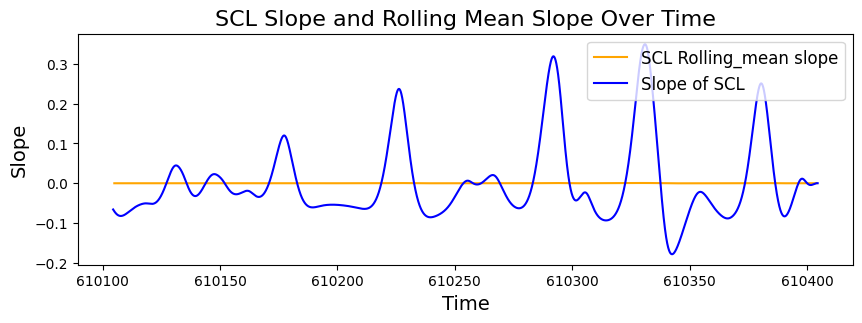

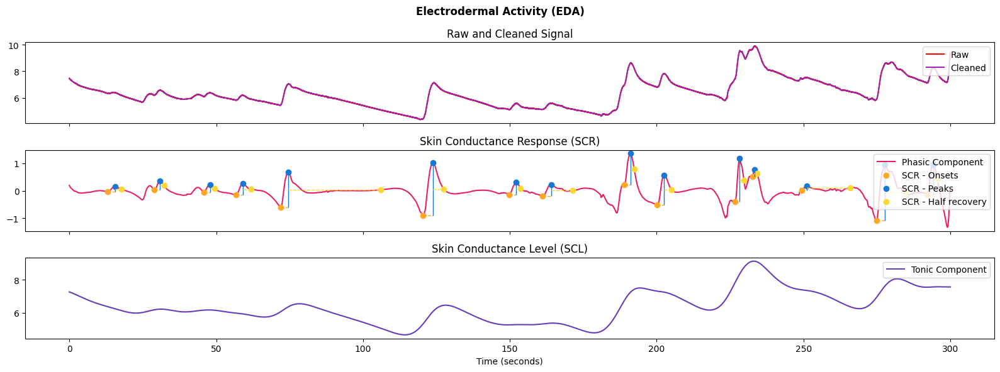

Effective sampling rate: 600.4145
Signal to Noise Ratio: 10.3196
Breath amplitude mean: 0.5369
Breath amplitude std: 0.4304
Breath amplitude range: 0.0976 - 2.8437
Respiration rate mean: 20.2126
Respiration rate std: 2.3910
Respiration rate range: 8.1499 - 27.5811
Peak to peak interval mean: 3.1651
Peak to peak interval std: 3.3782
Peak to peak interval range: 0.4730 - 82.3933
Baseline drift: 0.0827
Autocorrelation at typical breath cycle: 0.0937
Effective sampling rate: 44097.3053
Difference between .wav file and lsl timestamps durations: 0.1190
number of NaN's: 0 
percent of NaN's: 0.0000%
mic samples first quartile: -35.0 
mic samples third quartile: 35.0
mic samples standard deviation: 136.4934
mic samples min: -6672 
mic samples max: 4976
RestingState duration matches camera duration!
RestingState:  299.99936335068196
Webcam Stream:  299.97407943115104


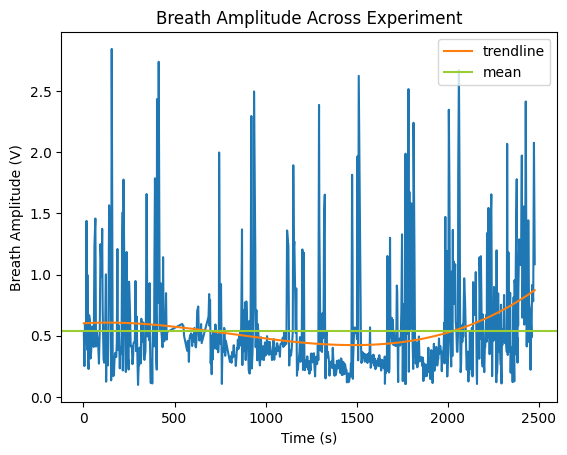

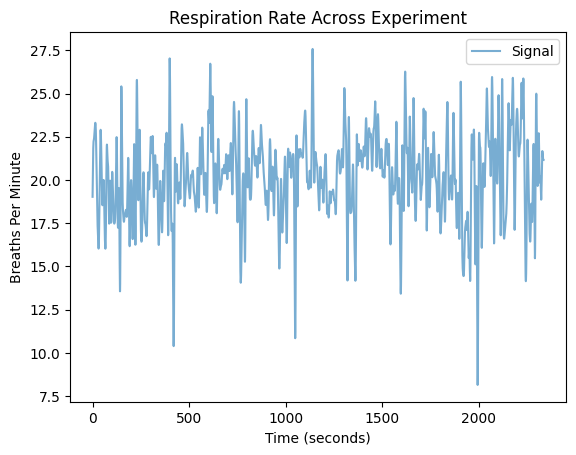

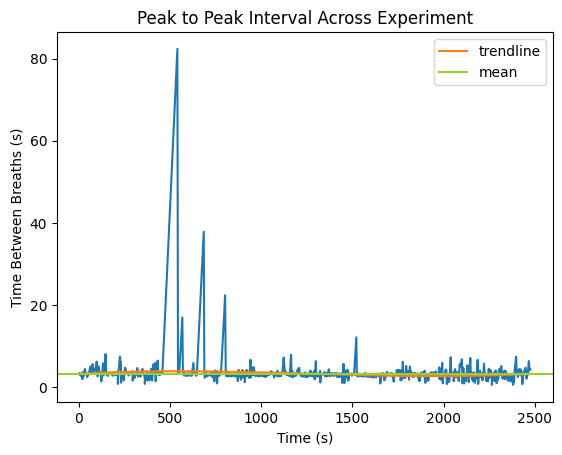

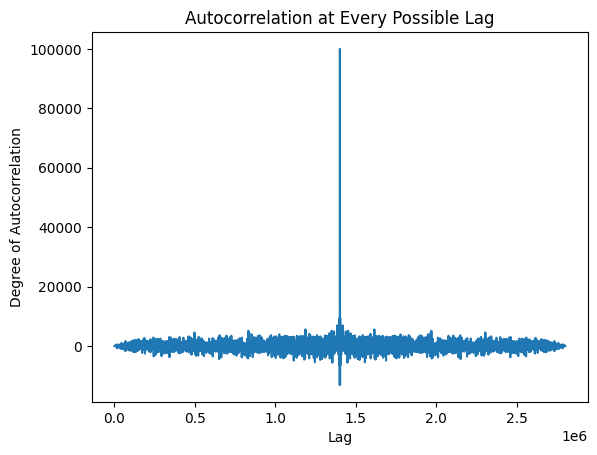

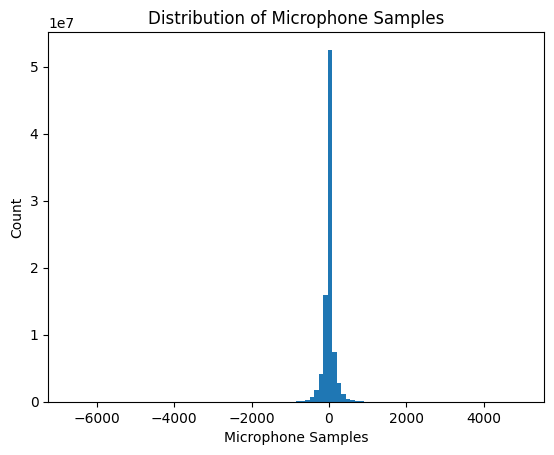

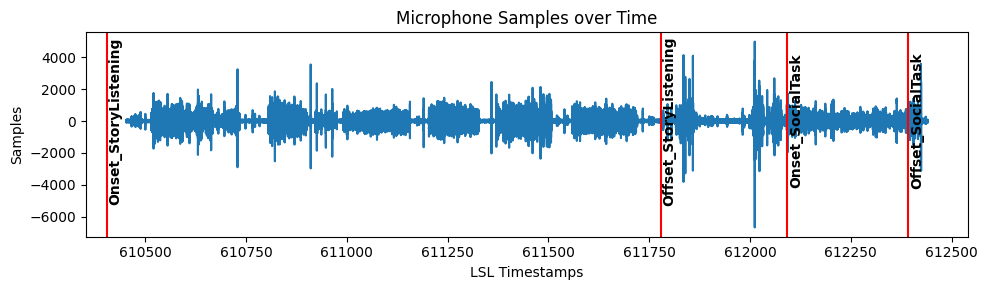

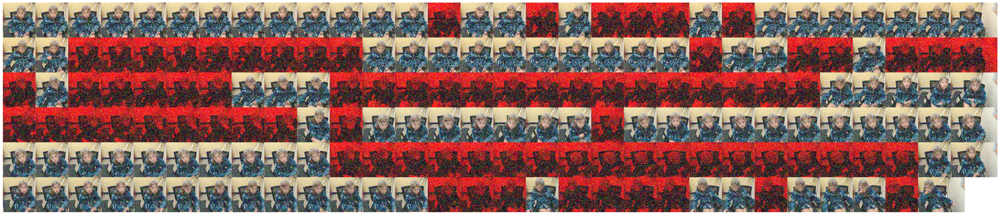

Missing stimulus markers: None
Duration of experiment: 39:01
Durations do not match expected length: ['Onset_CampFriend', 'Onset_FrogDissection', 'Onset_DanceContest', 'Onset_ZoomClass', 'Onset_Tornado', 'Onset_BirthdayParty']
299.99936335068196
Is Resting state of expected duration? True
300.49362628150266
Is Social script of expected duration? True
Duration of Impedance check: 04:42
Are all 10 seconds rest equal? True
Average response time across all story listening tasks: 00:34


In [15]:
path_files = glob('/Users/apurva.gokhe/Documents/CUNY_QC/data/*/*.xdf')[0]
add_to_csv(path_files)
# for subject in path_files:
#     add_to_csv(subject)

#     print('Done')

In [31]:
existing_data = pd.read_csv("/Users/apurva.gokhe/Documents/GitHub/MOBI_QC/src/MOBI_QC/important_files/CUNY_QC.csv")

def check(path, subject_id, task):
    existing_data = pd.read_csv(path)  
    row = existing_data.loc[existing_data['Subject'] == subject_id]
    print(row)
    if True: #existing_data.iloc(existing_data['Subject'] == subject_id): #and (existing_data['Task'] == task)]:
        print(subject_id, existing_data.index[existing_data['Subject'] == subject_id])
        print(task, existing_data.index[existing_data['Task'] == task])
        if task in row['Task']:
            print('this is it') 
        #rows = existing_data.loc[existing_data['Subject'] == subject_id]
        #return rows
    else:
        return None

In [32]:
result = check("/Users/apurva.gokhe/Documents/GitHub/MOBI_QC/src/MOBI_QC/important_files/CUNY_QC.csv", 'P5029423', 'Experiment')
print(result)


    Subject      Collection Date        Task  \
1  P5029423  2025-01-29 11:21:20  CampFriend   
2  P5029423  2025-01-29 11:21:20  Experiment   

                             eeg_bad_channels_before  \
1  ['E89', 'E74', 'E83', 'E77', 'E7', 'E84', 'E12...   
2  ['E89', 'E74', 'E83', 'E77', 'E7', 'E84', 'E12...   

                           eeg_interpolated_channels eeg_bad_channels_after  \
1  ['E89', 'E74', 'E8', 'E77', 'E84', 'E128', 'E9...  ['E73', 'E63', 'E82']   
2  ['E89', 'E74', 'E8', 'E77', 'E84', 'E128', 'E9...  ['E73', 'E63', 'E82']   

   eeg_percent_good  et_sampling_rate  et_flag1  et_flag2  ...  mic_max  \
1         89.693828        119.995725      True      True  ...     2837   
2         89.693828        119.995725      True      True  ...     2837   

   webcam_collected_full_Experiment  webcam_sampling_rate  webcam_face_perc  \
1                              True             30.040601               1.0   
2                              True             30.040601       

In [1]:
path_files = glob('/Users/apurva.gokhe/Documents/CUNY_QC/data/*/*.xdf')
path_files

NameError: name 'glob' is not defined

In [ ]:
def unpack_vars(lsl_vars, duration_vars):
    # Unpack lsl vars
    lsl_prob_vars = {}
    for key in lsl_vars.keys():
        if isinstance(lsl_vars[key], pd.DataFrame):
            lsl_k = lsl_vars[key].to_dict(orient='records')
            for i in range(len(lsl_k)):
                lsl_dict = {f"{lsl_k[i]['modality']}_{k}": v for k, v in lsl_k[i].items() if k != "modality" and k!='subject'}
                lsl_prob_vars.update(lsl_dict)
        else:
            lsl_prob_vars.update({key:lsl_vars[key]})
    
    # Unpack stream durations
    stream = duration_vars['Durations of each modality + comparison to expected duration:'].to_dict(orient='records')
    stream_vars = {}
    for i in range(len(stream)):
        stream_dict = {f"{stream[i]['stream']}_{k}": v for k, v in stream[i].items() if k != "stream"}
        stream_vars.update(stream_dict)
    return lsl_prob_vars, stream_vars

In [ ]:
def generate_qc_dataframe(subject_id:str, collection_date: str, modality_vars):
    
    subject_csv = {'Subject': subject_id, 'Collection Date': collection_date}
    for modality in modality_vars:
        subject_csv.update(modality)
    subject_csv_df = pd.DataFrame([subject_csv])

    return subject_csv_df

In [ ]:
collection_date = get_collection_date(xdf_filename)
modality_vars['lsl_vars'], modality_vars['duration_vars'] = unpack_vars(modality_vars['lsl_vars'], modality_vars['duration_vars'])

subject_csv_df = generate_qc_dataframe(subject, collection_date, modality_vars.values())
subject_csv_df

# Q1, Q3 of quantitaitve measures

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
qc_csv = pd.read_csv('/Users/apurva.gokhe/Documents/Github/MOBI_QC/src/MOBI_QC/important_files/CUNY_QC.csv')

In [11]:
def get_quartiles(metric):
    q1 = np.percentile(metric, 25)
    q3 = np.percentile(metric, 75)
    return q1, q3

In [15]:
q1, q3 = get_quartiles(heart_rate)
print(q1, q3)

75.14156700063958 77.57921111561615


In [ ]:
plt.figure(figsize=(6, 4))
sns.boxplot(x=heart_rate)
plt.title('Box and Whiskers Plot of Average Heart Rate')
plt.ylabel('Average Heart Rate')
plt.tight_layout()
plt.show()